<a href="https://colab.research.google.com/github/SichenPa221/Image-processing/blob/main/TP_1_ATSI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
colaboratory=True
import tempfile
import numpy as np
import IPython
import matplotlib.pyplot as plt


#if colaboratory:
#  !pip install soundfile
#  from IPython.display import Audio
#  !pip install bokeh
#  from bokeh.plotting import figure, output_file, show
#  from bokeh.plotting import show as showbokeh
#  from bokeh.io import output_notebook
#  output_notebook()

In [26]:
import numpy as np
import platform
import tempfile
import os
#import matplotlib.pyplot as plt
from scipy import ndimage as ndi
# necessite scikit-image
from skimage import io as skio

import skimage
import pickle
import scipy.signal as signal

import skimage.transform
def viewimage(im, normalize=True,titre='',displayfilename=False):
   imin=im.copy().astype(np.float32)
   if normalize:
       imin-=imin.min()
       if imin.max()>0:
           imin/=imin.max()
   else:
       imin=imin.clip(0,255)/255


   imin=(imin*255).astype(np.uint8)
   filename=tempfile.mktemp(titre+'.png')
   if displayfilename:
       print (filename)
   plt.imsave(filename, imin, cmap='gray')
   IPython.display.display(IPython.display.Image(filename))

#La fonction viewimage_color est la même que viewimage. Ca a l'air de marcher
def viewimage_color(im, normalize=True,titre='',displayfilename=False):
   imin=im.copy().astype(np.float32)
   if normalize:
       imin-=imin.min()
       if imin.max()>0:
           imin/=imin.max()
   else:
       imin=imin.clip(0,255)/255


   imin=(imin*255).astype(np.uint8)
   filename=tempfile.mktemp(titre+'.png')
   if displayfilename:
       print (filename)
   plt.imsave(filename, imin, cmap='gray')
   IPython.display.display(IPython.display.Image(filename))

def view_spectre(a,option=1,titre=''):
    """ Affiche le spectre d'une image
    Option=1: affichage lineaire, option=2: affichage log"""
    A=abs(fft2(a))
    A=ifftshift(A)
    if option==1:
      viewimage(A,titre=titre)
    else:
      viewimage(log(0.1+A),titre=titre)


sin=np.sin
cos=np.cos
fft2=np.fft.fft2
ifft2=np.fft.ifft2
fftshift=np.fft.fftshift
ifftshift=np.fft.ifftshift
pi=np.pi
log=np.log
real=np.real
conj=np.conj
def conv2(im,h,option='same'):
    """ Renvoie la convolution de l'image im avec le noyau h

    par défaut option='same' signifie que l'image renvoyée est de la même taille que im.
    L'option 'full' donne toute la convolution (taille N+M-1 si N et M sont les tailles des entrées)."""
    return signal.convolve2d(im,h,option)
i=np.complex(0,1)
exp=np.exp
angle=np.angle


<ipython-input-26-485a302314ff>:77: DeprecationWarning: `np.complex` is a deprecated alias for the builtin `complex`. To silence this warning, use `complex` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.complex128` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  i=np.complex(0,1)


In [27]:
#Charger les donnees
if colaboratory:
  !wget https://perso.telecom-paris.fr/gousseau/ATSI/TP/images.zip
  !unzip images.zip
  %cd ./images/

--2024-01-11 08:45:39--  https://perso.telecom-paris.fr/gousseau/ATSI/TP/images.zip
Resolving perso.telecom-paris.fr (perso.telecom-paris.fr)... 137.194.22.227, 2a04:8ec0:0:a::89c2:16e3
Connecting to perso.telecom-paris.fr (perso.telecom-paris.fr)|137.194.22.227|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://perso.telecom-paristech.fr/gousseau/ATSI/TP/images.zip [following]
--2024-01-11 08:45:40--  https://perso.telecom-paristech.fr/gousseau/ATSI/TP/images.zip
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.22.227, 2a04:8ec0:0:a::89c2:16e3
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 31044585 (30M) [application/zip]
Saving to: ‘images.zip’

images.zip          100%[===================>]  29.61M  13.3MB/s    in 2.2s    

2024-01-11 08:45:43 (13.3 MB/s) - ‘images.zip’ saved [31044585/31044585]

A

In [28]:
!pwd

/content/images/images


In [29]:
#definitions de fonctions utiles
def noise(im,br):
    """ Cette fonction ajoute un bruit blanc gaussier d'ecart type br
       a l'image im et renvoie le resultat"""
    imt=np.float32(im.copy())
    sh=imt.shape
    bruit=br*np.random.randn(*sh)
    imt=imt+bruit
    return imt

def quantize(im,n=2):
    """
    Renvoie une version quantifiee de l'image sur n (=2 par defaut) niveaux
    """
    imt=np.float32(im.copy())
    if np.floor(n)!= n or n<2:
        raise Exception("La valeur de n n'est pas bonne dans quantize")
    else:
        m=imt.min()
        M=imt.max()
        imt=np.floor(n*((imt-m)/(M-m)))*(M-m)/n+m
        imt[imt==M]=M-(M-m)/n #cas des valeurs maximales
        return imt


def seuil(im,s):
    """ renvoie une image blanche(255) la ou im>=s et noire (0) ailleurs.
    """
    imt=np.float32(im.copy())
    mask=imt<s
    imt[mask]=0
    imt[~mask]=255
    return imt

def gradx(im):
    "renvoie le gradient dans la direction x"
    imt=np.float32(im)
    gx=0*imt
    gx[:,:-1]=imt[:,1:]-imt[:,:-1]
    return gx

def grady(im):
    "renvoie le gradient dans la direction y"
    imt=np.float32(im)
    gy=0*imt
    gy[:-1,:]=imt[1:,:]-imt[:-1,:]
    return gy
def view_spectre(im,option=1,hamming=False):
    """ affiche le spectre d'une image
     si option =1 on affiche l'intensite de maniere lineaire
     si option =2 on affiche le log
     si hamming=True (defaut False) alors une fenetre de hamming est appliquee avant de prendre la transformee de Fourier
     """
    imt=np.float32(im.copy())
    (ty,tx,z)=im.shape
    pi=np.pi
    if hamming:
        XX=np.ones((ty,1))@(np.arange(0,tx).reshape((1,tx)))
        YY=(np.arange(0,ty).reshape((ty,1)))@np.ones((1,tx))
        imt=(1-np.cos(2*pi*XX/(tx-1)))*(1-np.cos(2*pi*YY/(ty-1)))*imt
    aft=np.fft.fftshift(abs(np.fft.fft2(imt)))

    if option==1:
        viewimage(aft)
    else:
        viewimage(np.log(0.1+aft))

def filterlow(im):
    """applique un filtre passe-bas parfait a une image (taille paire)"""
    (ty,tx)=im.shape
    imt=np.float32(im.copy())
    pi=np.pi
    XX=np.concatenate((np.arange(0,tx/2+1),np.arange(-tx/2+1,0)))
    XX=np.ones((ty,1))@(XX.reshape((1,tx)))

    YY=np.concatenate((np.arange(0,ty/2+1),np.arange(-ty/2+1,0)))
    YY=(YY.reshape((ty,1)))@np.ones((1,tx))
    mask=(abs(XX)<tx/4) & (abs(YY)<ty/4)
    imtf=np.fft.fft2(imt)
    imtf[~mask]=0
    return np.real(np.fft.ifft2(imtf))

def filtergauss(im):
    """applique un filtre passe-bas gaussien. coupe approximativement a f0/4"""
    (ty,tx)=im.shape
    imt=np.float32(im.copy())
    pi=np.pi
    XX=np.concatenate((np.arange(0,tx/2+1),np.arange(-tx/2+1,0)))
    XX=np.ones((ty,1))@(XX.reshape((1,tx)))

    YY=np.concatenate((np.arange(0,ty/2+1),np.arange(-ty/2+1,0)))
    YY=(YY.reshape((ty,1)))@np.ones((1,tx))
    # C'est une gaussienne, dont la moyenne est choisie de sorte que
    # l'integrale soit la meme que celle du filtre passe bas
    # (2*pi*sig^2=1/4*x*y (on a suppose que tx=ty))
    sig=(tx*ty)**0.5/2/(pi**0.5)
    mask=np.exp(-(XX**2+YY**2)/2/sig**2)
    imtf=np.fft.fft2(imt)*mask
    return np.real(np.fft.ifft2(imtf))


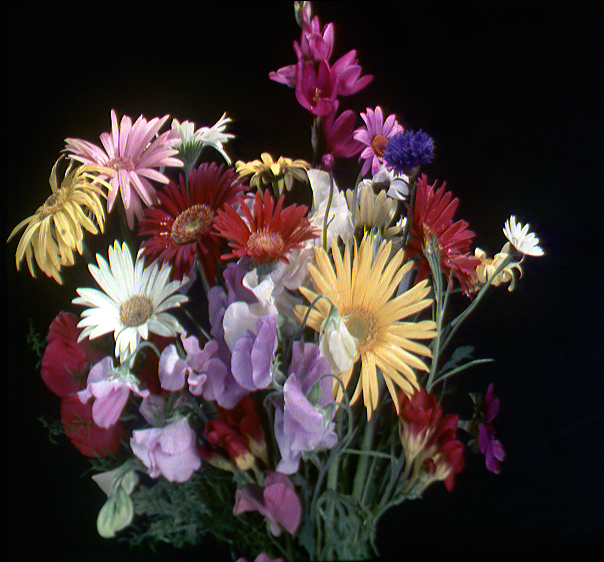

In [30]:
#%% EXEMPLE AFFICHAGE d'une image

if colaboratory:
  repimages='./'
else:
  repimages='/User/...' # A ADAPTER
a=(skio.imread(repimages+'fleur.tif'))
viewimage(a,titre='IMAGE')


In [31]:
a.shape


(562, 604, 3)

### 1. Linear intensity means that the values in the spectrum correspond directly to the magnitude of the Fourier coefficients without any transformation.

### 2. The logarithm of the intensity is taken to compress the range of values and make it more visually interpretable. The logarithmic transformation is applied to avoid overwhelming differences in intensity.



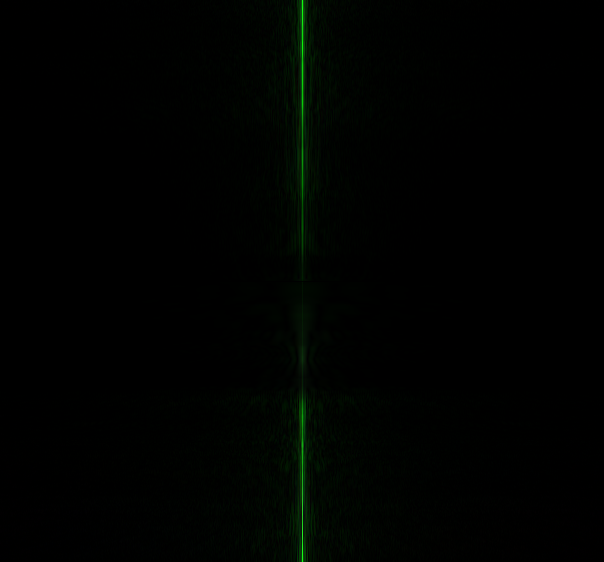

In [19]:
view_spectre(a,1)

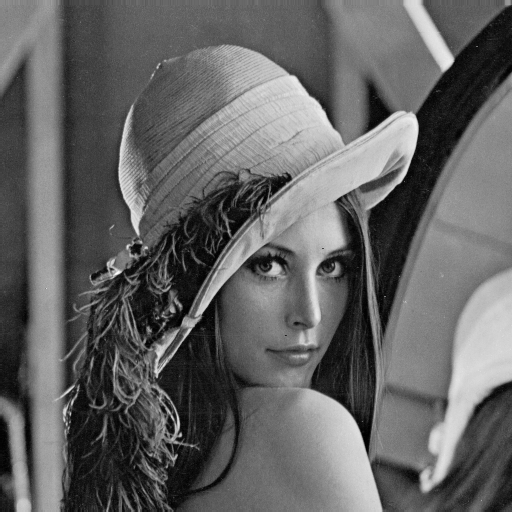

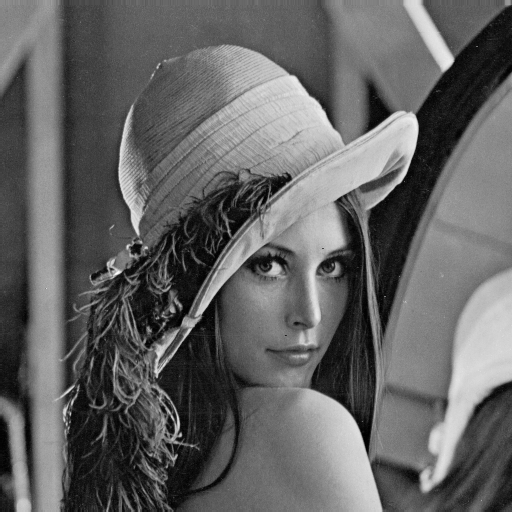

Help on function quantize in module __main__:

quantize(im, n=2)
    Renvoie une version quantifiee de l'image sur n (=2 par defaut) niveaux

(262144,)


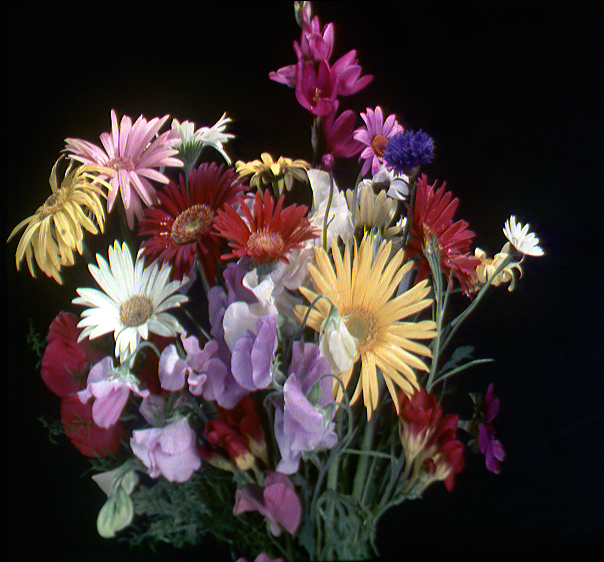

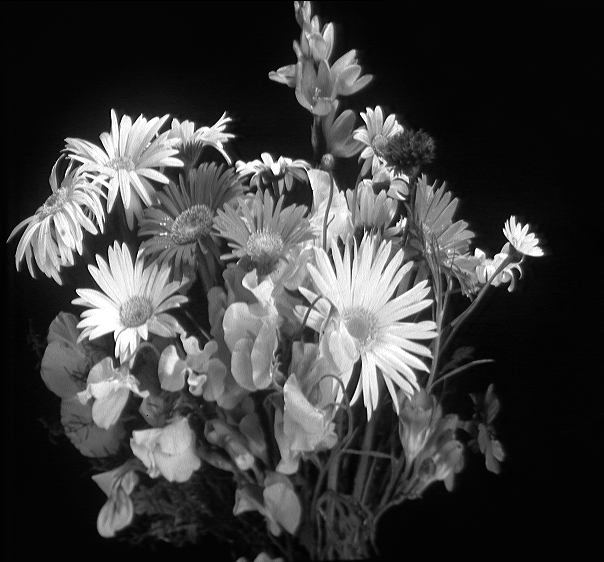

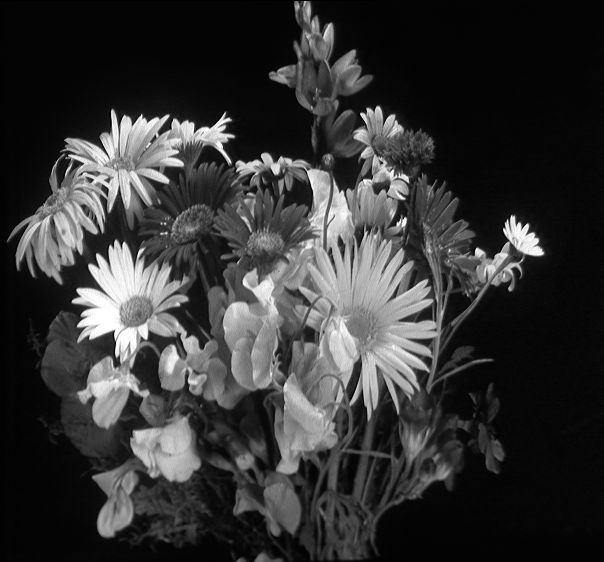

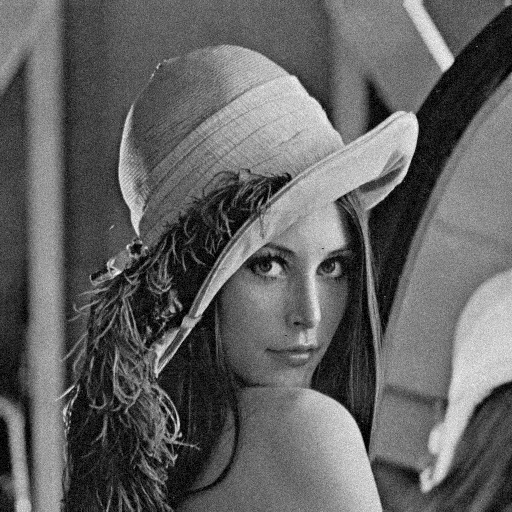

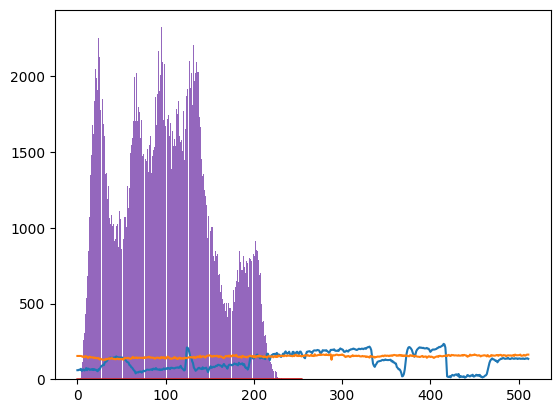

...

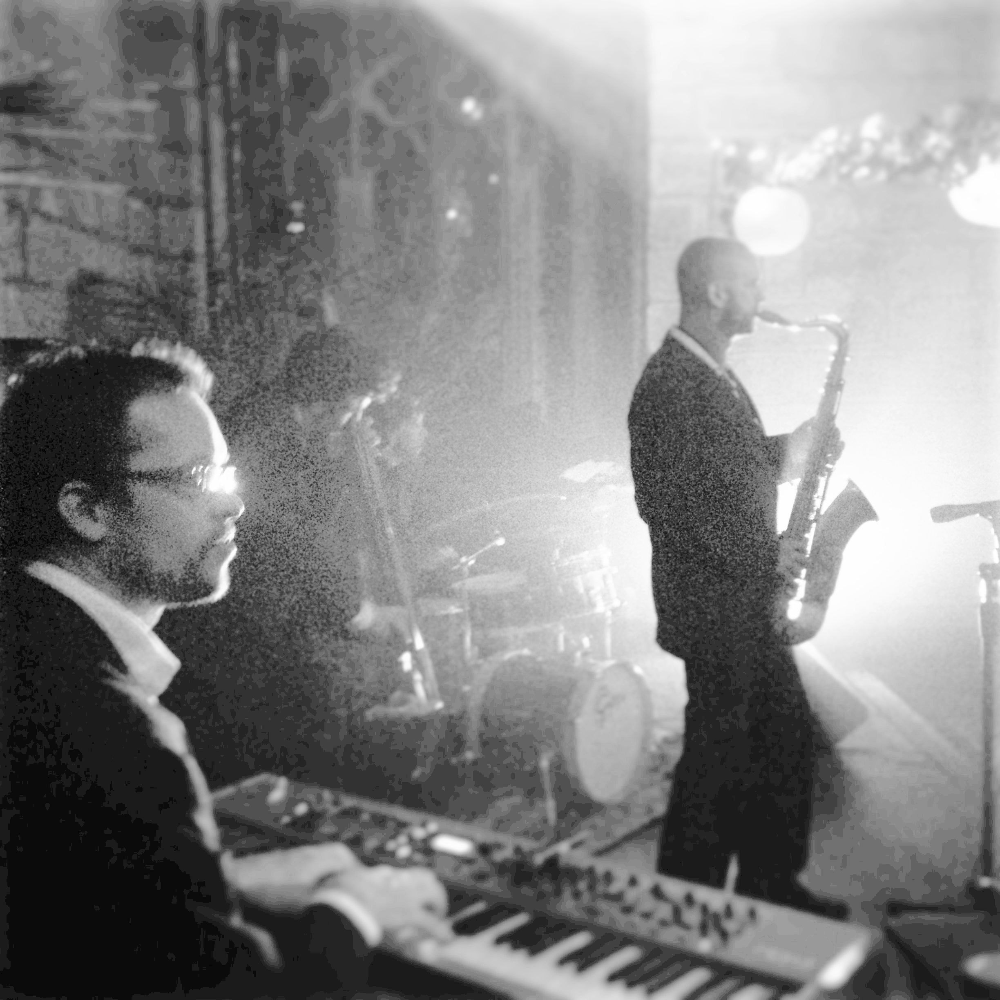

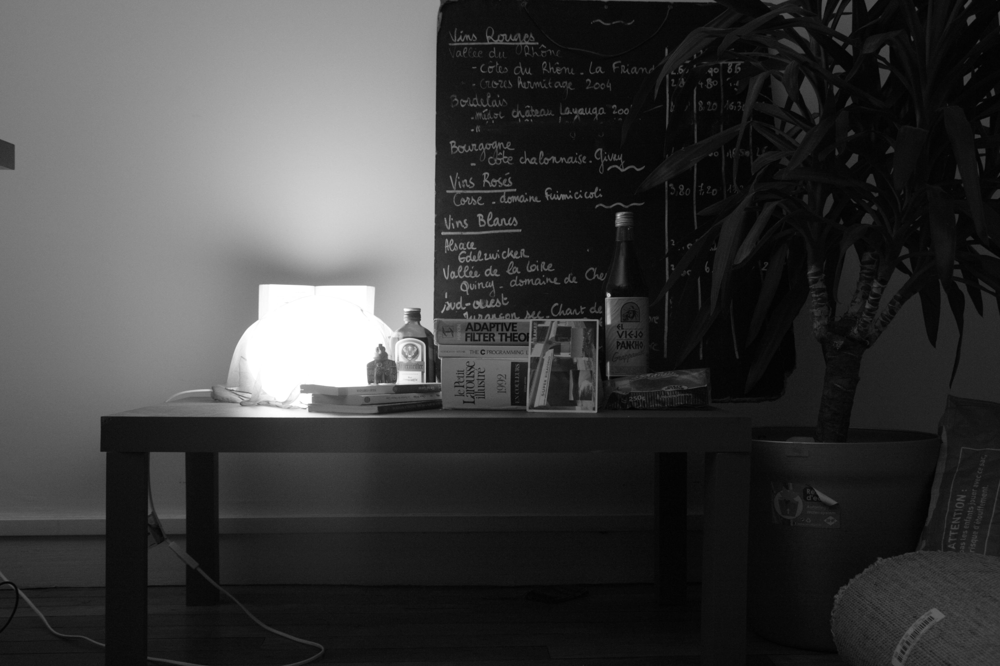

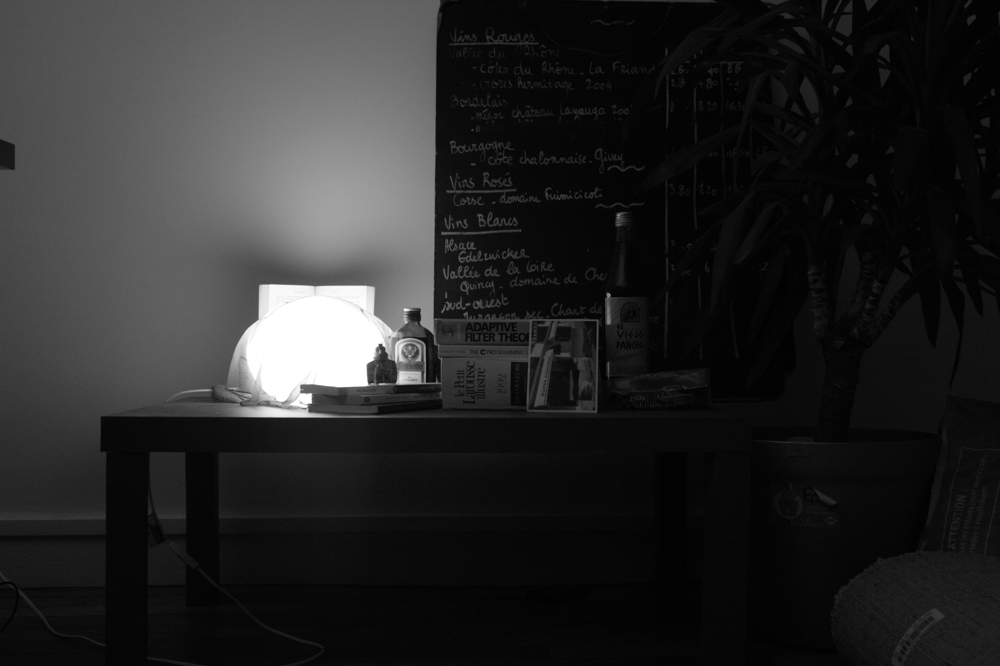

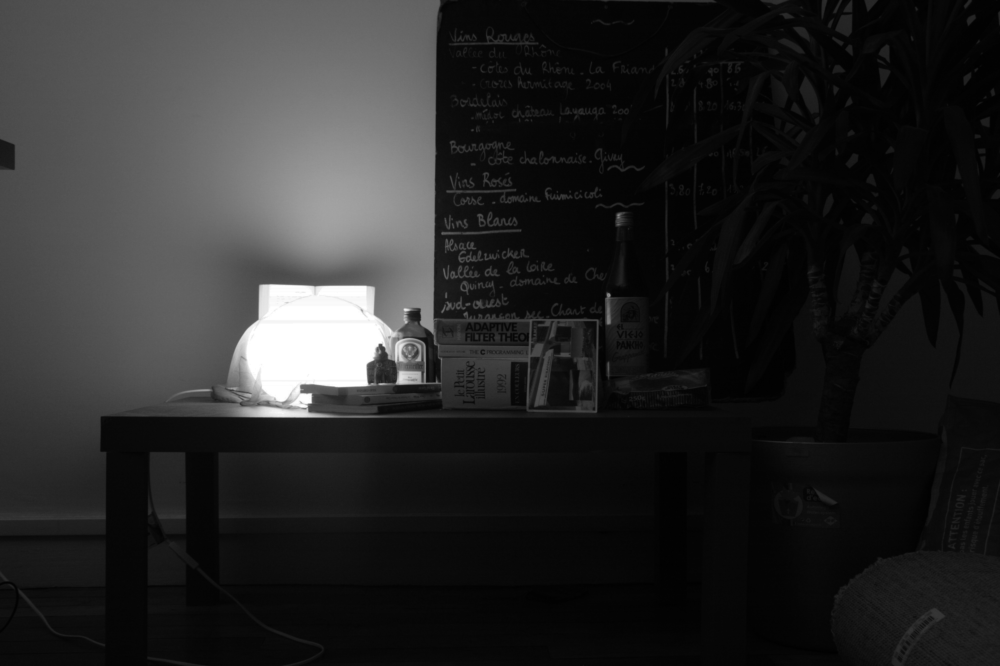

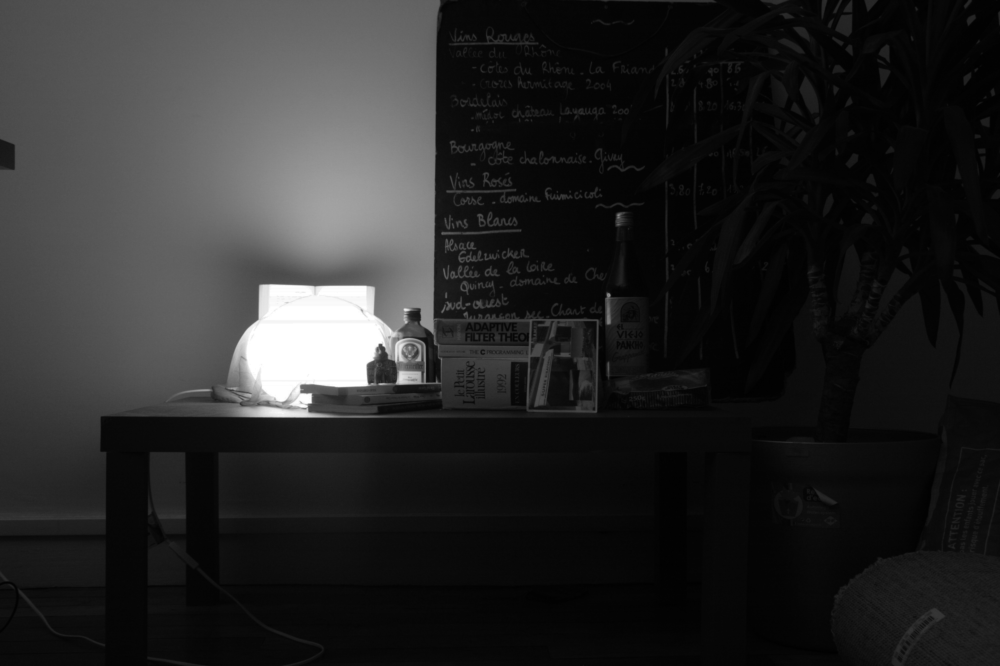

In [ ]:
############ NE PAS LANCER CETTE CELL
############### ELLE CONTIENT PLEIN d'EXEMPLE POUR CREER VOS PROPRES CELLULES
######CONTENANT LE CODE POUR FAIRE LE TP

#charger une image
a=np.float32(skio.imread(repimages+'lena.tif')) #float32 si on veut faire des
                                      #traitement sans probleme d'entiers...
viewimage(a,titre='LENA')

im = a.copy()
# connaitre la taille de l'image
im.shape = a.shape

#avoir la valeur d'un pixel
im[9,8] #pixel en y=9 et x=8

# visualiser l'image (elle en niveaux de gris)
viewimage(im)
# afficher une ligne d'une image comme un signal
# par exemple on affiche la ligne y=129


plt.plot(im[129,:])
# colonne x=45
plt.plot(im[:,45])

# maximum d'une image
im.max()
# minimum
im.min()
#minimum d'une ligne
im[129,:].min()

# transformation en image a valeurs reelles
imfloat= np.float32(im)
# valeur absolue d'une image
abs(im)
# pour obtenir de l'aide
help(quantize)
# transformerun tableau en une line
r=im.reshape( ( -1,))
print (r.shape)
#%% une image couleur
im=skio.imread('fleur.tif')
viewimage_color(im,normalize=False) #on ne normalise pas pour garder l'image comme
                                    # a l'origine
# voir un seul canal (rouge)
viewimage(im[:,:,0])
viewimage(im.mean(axis=2)) #la moyenne des trois canaux
#%%
#histogrammes
# simple visualisation
im=skio.imread('lena.tif')
plt.hist(im.reshape((-1,)),bins=255) #le reshape transforme en tableau 1D
#%%
#calcul d'un histogramme cumule
(histo,bins)=np.histogram(im.reshape((-1,)),np.arange(0,256)) #le reshape est inutile pour np.histogram, mais on le laisse pour la compatibilite avec plt.hist
histo=histo/histo.sum()
histocum=histo.cumsum()
plt.plot(histocum)

#%% ajout de bruit
imbr=noise(im,10)
viewimage_color(imbr,normalize=False)
#effet sur l'histogramme
plt.hist(im.reshape((-1,)),255)
plt.show()
plt.hist(imbr.reshape((-1,)),255)
plt.show()

#%% egalisation d'histogramme
im=skio.imread('sombre.jpg')
im=im.mean(axis=2) #on est sur que l'image est grise
viewimage(im)
(histo,bins)=np.histogram(im.reshape((-1,)),np.arange(0,256)) #le reshape en inutile pour np.histogram, mais on le laisse pour la compatibilite avec plt.hist
histo=histo/histo.sum()
histocum=histo.cumsum()
imequal=histocum[np.uint8(im)]
viewimage(imequal)

#%%
u=skio.imread('vue1.tif')
v=skio.imread('vue2.tif')
viewimage(u)
viewimage(v)
#
ind=np.unravel_index(np.argsort(u, axis=None), u.shape) #unravel donne les index 2D a partir des index 1d renvoyes par argsort (axis=None)
unew=np.zeros(u.shape,u.dtype)
unew[ind]=np.sort(v,axis=None)
viewimage(unew) #u avec l'histogramme de v

#DE MANIERE EQUIVALENTE et Peut-etre plus claire

ushape=u.shape
uligne=u.reshape((-1,)) #transforme en ligne
vligne=v.reshape((-1,))
ind=np.argsort(uligne)
unew=np.zeros(uligne.shape,uligne.dtype)
unew[ind]=np.sort(vligne)
# on remet a la bonne taille
unew=unew.reshape(ushape)
viewimage(unew)


viewimage(abs(np.float32(u)-np.float32(v)))

#%% quantification dithering

im=skio.imread('lena.tif')
im2=quantize(im,2)
viewimage(im2)

viewimage(seuil(noise(im,40),128)) #exemple de dithering

#%% log d'un histogramme
plt.plot(np.log(np.histogram(gradx(im),255)[0]))
#%%
im=skio.imread('lena.tif')
view_spectre(im,option=2,hamming=True)
#%% FIN TP INTRODUCTION



In [ ]:
#%% affichage spectre en log/ sans log
a=charge_image('maison.tif')
A=fft2(a); A=fftshift(A);
affiche(a,titre='Image')
affiche_spectre(a,titre='echelle lineraire')
affiche(log(0.1+abs(A)),titre='echelle log')
#%%

def affiche_spectre_log(a,titre=''):
    A=abs(fft2(a))
    A=ifftshift(A)
    affiche(log(0.1+A),titre=titre)


#Commentaires:
Les images sont des phénomène très basse fréquence. La fréquence 0 domine toutes les autres en puissance et si l'on veut analyser leur spectre (ou simplement voir quelque chose de plus qu'un point lumineux au centre) il faut prendre le logarithme.

 Les droites que l'on voit sur la TF sont dues aux discontinuités droites dans l'image. Chaque discontinuité droite engendre une droite orthogonale dans le spectre.

 Très souvent les images ne sont pas continues si on compare la ligne du bas avec celle du haut ou la colonne la plus àà droite avec celle la plus àà gauche. Cette discontinuité engendre une croix horizontale/verticale que l'on retrouve presque toujours dans une TFD2D d'une image. Pour les éliminer il faudrait multiplier l'image par une fenêtre de Hamming (2D) avant de calculer le spectre).



In [ ]:
#%%
a=charge_image('carte.gif')
affiche(a,titre='image normale')
b=a[::2,::2]
affiche(b,titre='image sous-echantillonnee')
#%%
affiche_spectre_log(a,titre='spectre normal')
affiche_spectre_log(b,titre='spectre de l''image sous-echantillonnee')


#Commentaires:
On remarque des strilles sur l'image originale (celles autour des "Us" dans la carte). Elles engendre deux points lumineux dans la TFD2D situées en (coordonnées Bokeh) (173,33) et (85,220) (approximativement). La direction entre ces deux points est bien orthogonale aux strilles et le milieux est bien (presque) (128,128) soit le zéro fréquentiel.

Lorsque l'on sous-échantillonne chacun de ces points devient quatre répliques (on va soustraire le point central (128,128)) en se déplaçant dans chaque dimension de 128 pixels (1/2 en fréquence réduite).

 Nous allons écrire les répliques du point (173,33)=(128,128)+(45,-95). On ne garde que le représentant dans (-128,-128)...(+128,128)

 A) (45,-95)+(0,0)=(45,-95)

 B) (45-128,-95)=(-83,-95)

 C) (45,-95+128)=(45,33)

D) (45-128,-95+128)=(-83,33)

 Mais la TFD de l'image deux fois plus petite a des coordonnées entre -64 et +64. La seule réplique qui rentre dans ces coordonnées est la C, (45,33). Il convient d'ajouter le point centrale pour trouver la position finale (45,33)+(64,64)=(109,97).

  Effectivement, on voit un point lumineux en (109,97) dans le spectre de l'image sous-échantillonnée. Ce point correspond à la nouvelle orientation des strilles.


#Elimination de cet effet:
Dans la cellule ci-dessus on filtre (passe-bas) avant d'échantillonner

In [ ]:
#%%
a=charge_image('carte.gif')
affiche(a,titre='image normale')
filt_pb1d=np.asarray([1,1.5,2,3,2,1.5,1])
filt_pb1d/=filt_pb1d.sum() #normalisation
filt_tp2d=filt_pb1d.reshape((-1,1))@filt_pb1d.reshape((1,-1))
filt_pb2d=np.ones((5,5))/25
c=conv2(a,filt_tp2d,'same'); #conv2 effectue la convolution bidimensionnelle
d=c[::2,::2]

affiche(d,titre='image filtree sous-echantillonnee')
#%%
#%%

affiche_spectre_log(a,titre='spectre normal')
affiche_spectre_log(c,titre='spectre de l''image filtree')
affiche_spectre_log(d,titre='spectre de l''image filtree puis sous-echantillonnee')


In [ ]:

#%%
c=conv2(a,np.ones((3,3))/9,'same'); #conv2 effectue la convolution bidimensionnelle
affiche(c[::2,::2])


In [ ]:

#%%
a=charge_image('chapeau.tif')
b=charge_image('maison.tif')
A=fft2(a); B=fft2(b);
Ap=exp(i*angle(A))*abs(B); #module de la TFD de b et phase de A
Bp=exp(i*angle(B))*abs(A);
ap=real(ifft2(Ap)); affiche(ap,titre='module_b_phase_a');
bp=real(ifft2(Bp)); affiche(bp,titre='module_a_phase_b');


#Commentaires:

 Comme vu en cours, pour les images "géométriques" c'est la phase de la TFD qui porte la position des objets et cela fait que l'on reconnait l'image du moment que l'on a gardé la phase de sa TFD.

  Pour les images de texture c'est plus le module qui porte l'infomation. D'où la méthode de synthèse de texture consistant à plaquer une phase aléatoire sur le TFD2D d'une texture pour en générer une nouvelle.
  

In [ ]:

#%% Synthèse de teture
a=charge_image('bois.tif')
(m,n)=a.shape
b=np.random.randn(m,n)
A=fft2(a)
B=fft2(b)
C=abs(A)*exp(i*angle(B))
c=real(ifft2(C))
affiche(c, titre='synthese')
affiche(a,titre='originale')


In [ ]:

#%% Filtrage passe-haut
a=charge_image('maison.tif')
fx=np.asarray([[0 ,0, 0],[-1 ,1, 0],[ 0 ,0, 0]])
fy=fx.T
gx=conv2(a,fx) # conv2 effectue une convolution bi-dimensionnelle
gy=conv2(a,fy)
affiche(abs(gx),titre='derivee_en_x')
affiche(abs(gy),titre='derivee_en_y')
g=(gx**2+gy**2)**0.5
affiche(g,titre='Norme_du_gradient')


In [ ]:

#%%
fm=np.ones((3,3))/9
conv2(fm,fx,option='full') #Q4.1


array([[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [-0.11111111,  0.        ,  0.        ,  0.11111111,  0.        ],
       [-0.11111111,  0.        ,  0.        ,  0.11111111,  0.        ],
       [-0.11111111,  0.        ,  0.        ,  0.11111111,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ]])

In [ ]:
#%% UNsharp mask
a=charge_image('flou.jpg');
laplace=np.ones((3,3)); laplace[::2,::2]=0; laplace[1,1]=-4; #filtre laplacien discret
dirac=np.zeros((3,3)); dirac[1,1]=1; #un dirac sur un support 3x3
alpha=3#taux de mélange
b=conv2(a,dirac-alpha*laplace);
affiche(a,titre='orig',normalise=False);
affiche(b,titre='net',normalise=False); #certaines valeurs vont dépasser 255 car la RI n'est pas positive


#Unsharp mask:
Ce que fait ce filtre est d'appliquer à l'envers dans le temps l'équation de la chaleur. Pour une courte période de temps cela permet de rendre plus nette l'image, mais si on simule une plus longue période (alpha grand) cela devient instable.

 L'équation de la chaleur est l'archétype du flou. Les particules de chaleurs se déplacent aléatoirement vers les positions voisines et au final l'image devient floue. Renverser ce processus est un moyen d'espérer retrouver d'où viennent les particules de chaleur et donc de déflouter une image. C'est un problème très mal posé d'où l'instabilité numérique (sauf pour alpha petit).

In [ ]:
#%%
def appareil_photo(im,dy,dx):
    """Une fonction qui simule un appareil photo"""
    sousech=2
    h=np.ones((3,3))/9
    (nl,nc)=im.shape
    flou=real(ifft2(fft2(h,s=(nl,nc))*fft2(im)))
    out=flou[dy::sousech,dx::sousech]
    return out

def zoomimage(im):
    """ zoom une image d'un facteur 2"""
    (m,n)=im.shape
    out=np.zeros((2*m,2*n))
    out[::2,::2]=im
    out[1:-1:2,::2]=1/2*(out[:-2:2,::2]+out[2::2,::2]) #moyenne en y pour trouver les pixels du type (2k+1,2l)
    out[::2,1:-1:2]=1/2*(out[::2,:-2:2]+out[::2,2::2])
    out[1:-1:2,1:-1:2]=1/4*(out[:-2:2,2::2]+out[2::2,:-2:2]+out[2::2,2::2]+out[:-2:2,:-2:2]) # pixels (2k+1,2l+1)
    return out
def trouve_decalage(i1,i2):
    """ fonction qui trouve le decalage entre deux images sous-echantillnnees"""
    im1=zoomimage(i1)
    im2=zoomimage(i2)
    fim1=fft2(im1);
    fim2=fft2(im2);
    corr=real(ifft2(fim1*conj(fim2)))  # que serait le résultat sans conj( )?
    dx=corr.max(axis=0).argmax()
    dy=corr.max(axis=1).argmax()
    return (dy,dx)

def recalage(capte1,capte2,capte3,capte4):
    (m,n)=capte1.shape
    sortie=np.zeros((2*m,2*n))
    sortie[::2,::2]=capte1
    (dy2,dx2)=trouve_decalage(capte1,capte2)
    print("decalage 2:",dy2,dx2)
    sortie[dy2::2,dx2::2]=capte2
    (dy3,dx3)=trouve_decalage(capte1,capte3)
    print("decalage 3:",dy3,dx3)
    sortie[dy3::2,dx3::2]=capte3
    (dy4,dx4)=trouve_decalage(capte1,capte4)
    print("decalage 4:",dy4,dx4)
    sortie[dy4::2,dx4::2]=capte4
    return sortie
def defloute(re):
    """defloute la sortie de recalage"""
    h=np.random.randn(3,3) #ATTENTION C'EST FAUX (voir question Q5.1)
    h=np.ones((3,3))/9 # EN fait il faut mettre le même filtre que dans la fonction appareil_photo
    fh=fft2(h,s=(re.shape))
    fre=fft2(re)
    fdefloute=fre/fh
    return real(ifft2(fdefloute))
#%% Lecture des images qui ont ete prises grace a appareil photo (se mettre dans le repertoire des donnees)
f=open('donnees_super.pickle','rb')
(capte1,capte2,capte3,capte4)=pickle.load(f)
f.close()

affiche (capte1,titre='image_captee') # une image parmi celles captees
reconstruction=recalage(capte1,capte2,capte3,capte4)
affiche(reconstruction,titre='reconstruction_brute')
affiche(defloute(reconstruction),titre='defloutee')


decalage 2: 1 1
decalage 3: 1 0
decalage 4: 0 1


#Commentaires:

 Si l'image d'origine est I et h le filtre moyenneur de taille $3\times3$, alors l'appareil photo fait ceci:
 $$
 s=\Pi\left(T_{dx,dy}(h\star I)\right)
 $$
 Où $\Pi$ est l'échantllonnage de 2 en 2, $T_{dx,dy}$ le déécalage de $(dx,dy)$. L'image est floutée par $h$ puis décalée puis sous-échantillonnée.

  Ceci correspond à ce que fait un appareil photo. L'image continue est floutée par l'optique de l'appareil. Puis elle est échantillonnée sur les pixels. Le décalage est une vue de l'esprit pour rendre compte du fait que si on prend plusieurs fois la même photo il y aura toujours un décalage entre les photos car la taille des pixels est de l'ordre de $10^{-6}m$ (le micrometre) et qu'il est donc impossible de s'assurer que deux photos soient prises exactement sur la même grille. Bien sûr on a beaucoup simplifié la super-résolution dans ce cas, car on a, par "hasard", exactement les décalages qu'il faut pour reconstruire $h\star I$.

  Enfin, la fonction trouve_décalage fonctionne comme suit:
  
  A) Elle zoome ses deux images d'entrée afin de calculer des decalages qui seront sous-pixeliques en taille.

  B) Elle calcule la corréélation entre les images. La formule de la corrélation est
  $$
(I_1\star_{corr}I_2)(x,y)=\iint I_1(t,v)I_2(x+t,y+v)dtdv
  $$
  Elle revient à calculer la convolution entre $I_1$ et $\tilde{I_2}$ avec $\tilde{I_2}(x,y)=I_2(-x,-y)$. De manièère plus préécise:
  $$
  (I_1\star_{corr}I_2)(x,y)=(I_1\star\tilde{I_2})(-x,-y)
  $$

   Une autre interprétation de la formule de corrélation est que $$(I_1\star_{corr}I_2)(x,y)=\left<I_1|T_{(-x,-y)}(I_2)\right>$$
   Cette grandeur est maximale lorsque $I_2$ translatée de $(-x,-y)$ maximise le produit scalaire contre $I_1$. Le produit scalaire est grand quand les fonction se ressemblent (colinéaire).

 La fonction trouve_decalage trouve donc le décalage pour lequel la seconde image ressemble le plus à la première quand elle subit ce décalage.

  Une fois que l'on a calculé tous les décalage des images $I_2,I_3,I_4$ par rapport à $I_1$, on place toutes les images dans une seule grille. Il se trouve que nous avons par "hasard" les décalages (0,0) ($I_1$), (1,0),(0,1),(1,1) qui sont les quatre decalages necessaires quand on sous-echantillonne d'un facteur 2.

   Une fois toutes ces images placées le résultat est:
   $$
   I\star h
$$

 Le flou est encore là. Enfin la fonction defloute doit diviser la TF de $h\star I$ par la TF de $h$ pour obtenir celle de $I$.

  Cette technique de défloutage ne fonctionne pas dans la réalité car, les images continnent du bruit qui est très réhaussé par un tel défloutage.

   Mais dans le cas jouet que nous faisons ici, ce défloutage fonctionne.
